In [53]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [54]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff

In [55]:
from plotly.subplots import make_subplots
from scipy.stats import norm
from sklearn.preprocessing import MultiLabelBinarizer
from ydata_profiling import ProfileReport
from wordcloud import WordCloud

In [56]:
df = pd.read_csv(r"C:\Users\milen\OneDrive\Documentos\disney\disney_plus_titles.csv")
df.head(10)

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,Movie,Duck the Halls: A Mickey Mouse Christmas Special,"Alonso Ramirez Ramos, Dave Wasson","Chris Diamantopoulos, Tony Anselmo, Tress MacN...",NaN,"November 26, 2021",2016,TV-G,23 min,"Animation, Family",Join Mickey and the gang as they duck the halls!
1,s2,Movie,Ernest Saves Christmas,John Cherry,"Jim Varney, Noelle Parker, Douglas Seale",NaN,"November 26, 2021",1988,PG,91 min,Comedy,Santa Claus passes his magic bag to a new St. ...
2,s3,Movie,Ice Age: A Mammoth Christmas,Karen Disher,"Raymond Albert Romano, John Leguizamo, Denis L...",United States,"November 26, 2021",2011,TV-G,23 min,"Animation, Comedy, Family",Sid the Sloth is on Santa's naughty list.
3,s4,Movie,The Queen Family Singalong,Hamish Hamilton,"Darren Criss, Adam Lambert, Derek Hough, Alexa...",NaN,"November 26, 2021",2021,TV-PG,41 min,Musical,"This is real life, not just fantasy!"
4,s5,TV Show,The Beatles: Get Back,NaN,"John Lennon, Paul McCartney, George Harrison, ...",NaN,"November 25, 2021",2021,NaN,1 Season,"Docuseries, Historical, Music",A three-part documentary from Peter Jackson ca...
5,s6,Movie,Becoming Cousteau,Liz Garbus,"Jacques Yves Cousteau, Vincent Cassel",United States,"November 24, 2021",2021,PG-13,94 min,"Biographical, Documentary",An inside look at the legendary life of advent...
6,s7,TV Show,Hawkeye,NaN,"Jeremy Renner, Hailee Steinfeld, Vera Farmiga,...",NaN,"November 24, 2021",2021,TV-14,1 Season,"Action-Adventure, Superhero",Clint Barton/Hawkeye must team up with skilled...
7,s8,TV Show,Port Protection Alaska,NaN,"Gary Muehlberger, Mary Miller, Curly Leach, Sa...",United States,"November 24, 2021",2015,TV-14,2 Seasons,"Docuseries, Reality, Survival",Residents of Port Protection must combat volat...
8,s9,TV Show,Secrets of the Zoo: Tampa,NaN,"Dr. Ray Ball, Dr. Lauren Smith, Chris Massaro,...",United States,"November 24, 2021",2019,TV-PG,2 Seasons,"Animals & Nature, Docuseries, Family",A day in the life at ZooTampa is anything but ...
9,s10,Movie,A Muppets Christmas: Letters To Santa,Kirk R. Thatcher,"Steve Whitmire, Dave Goelz, Bill Barretta, Eri...",United States,"November 19, 2021",2008,G,45 min,"Comedy, Family, Musical",Celebrate the holiday season with all your fav...


In [57]:
report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [58]:
df.nunique()
#valores do dataframe

show_id         1450
type               2
title           1450
director         609
cast            1193
country           89
date_added       167
release_year      90
rating             9
duration         158
listed_in        329
description     1448
dtype: int64

In [59]:
df.isna().sum()
#verifica valores ausentes

show_id           0
type              0
title             0
director        473
cast            190
country         219
date_added        3
release_year      0
rating            3
duration          0
listed_in         0
description       0
dtype: int64

In [60]:
#director e cast: não são necessárias para a análise (sem muita informação).

#country: é uma variável importante,então será necessário corrigi-lá.

#date_added : Não foi possível achar os valores para esta coluna na internet, então as linhas que não contêm o valor serão descartadas, pois são apenas 3.

#rating : Irei fazer a substituição com dados tirados da disney;

In [61]:
df[df['rating'].isna()]

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
4,s5,TV Show,The Beatles: Get Back,NaN,"John Lennon, Paul McCartney, George Harrison, ...",NaN,"November 25, 2021",2021,NaN,1 Season,"Docuseries, Historical, Music",A three-part documentary from Peter Jackson ca...
276,s277,Movie,Disney My Music Story: Perfume,Kentaro Takayanagi,"a-chan , KASHIYUKA , NOCCHi",NaN,"March 19, 2021",2019,NaN,53 min,"Biographical, Documentary, Music",J-Pop band Perfume shares their passion for mu...
280,s281,TV Show,Marvel Studios ASSEMBLED,NaN,NaN,NaN,"March 12, 2021",2021,NaN,1 Season,"Anthology, Docuseries",ASSEMBLED is an immersive series of docu-speci...


In [62]:
rating_replacements = {
    4: 'TV-PG',
    276: 'TV-14',
    280: 'TV-MA'
}

for id, rate in rating_replacements.items():
    df.iloc[id, 8] = rate

df['rating'].isna().sum()

#corrijindo valores com o dicionario rating_replacements e usando Loop for para substituição.
#Esse loop percorre o dicionário, pegando o índice ( id) e o novo valor ( rate) 


0

In [63]:
#df.at[276, 'rating'] = 'TV-PG'  # Usando 'at' para alterar a célula
#print(df.at[276, 'rating'])  # Verifique se foi alterado corretamente

In [64]:
df = df.drop(['director', 'cast'], axis=1)
#removendo as colunas "director" e "cast" do DataFrame 

In [65]:
df = df[df['date_added'].notna()]
#remove as linhas do DataFrame onde a coluna "date_added" tem valores nulos (NaN) 

In [67]:
#Country
#os valores nulos serão trocados pelo país com maior numero de repetições na coluna.

df['country'] = df['country'].fillna(df['country'].mode()[0])

In [68]:
df.isna().sum()
#verifica se os dados estao limpos

show_id         0
type            0
title           0
country         0
date_added      0
release_year    0
rating          0
duration        0
listed_in       0
description     0
dtype: int64

In [69]:
#Datas
#Pra uma melhor visualização das datas elas sarão separadas em 3 colunas: 
#ano_adicionado, mes_adicionado e trimestre_adicionado.

df['ano_adicionado'] = pd.DatetimeIndex(df['date_added']).year
df['mes_adicionado'] = pd.DatetimeIndex(df['date_added']).month
df['trimestre_adicionado'] = pd.DatetimeIndex(df['date_added']).quarter

In [70]:
#Público alvo
#o público alvo será definido com base na Classificação Indicativa (rating).

In [71]:
classificacao_indicativa = {
    'TV-PG': 'Crianças mais velhas',
    'TV-MA': 'Adultos',
    'TV-MA ': 'Adultos',
    'TV-Y7-FV': 'Crianças mais velhas',
    'TV-Y7': 'Crianças mais velhas',
    'TV-14': 'Adolescentes',
    'R': 'Adultos',
    'TV-Y': 'Crianças',
    'NR': 'Adultos',
    'PG-13': 'Adolescentes',
    'TV-G': 'Crianças',
    'PG': 'Crianças mais velhas',
    'G': 'Crianças',
    'UR': 'Adultos',
    'NC-17': 'Adultos'
}

df['publico_alvo'] = df['rating'].replace(classificacao_indicativa)
df['publico_alvo'].unique()

array(['Crianças', 'Crianças mais velhas', 'Adolescentes', 'Adultos'],
      dtype=object)

In [72]:
#Country
#Em algumas linhas a coluna country contém uma lista com varios países. Para facilitar, será usado apenas o primeiro país de cada lista.
df['pais_principal'] = df['country'].apply(lambda x: x.split(",")[0])


In [73]:
#gênero
#a coluna listed_in tem os gêneros que pertencem aos filmes / programas de tv , porem eles estão juntos em apenas uma string, impossibilitando a leitura dos dados. Para que seja possível uma leitura de dados adequada é necessário separar todos os gêneros em uma nova coluna.
df['genero'] = df['listed_in'].apply(lambda x :  x.replace(' ,',',').replace(', ',',').split(',')) 

In [74]:
#Type e publico_alvo
#As colunas type e publico_alvo devem ser uma categoria.
df['type'] = pd.Categorical(df['type'])

df['publico_alvo'] = pd.Categorical(df['publico_alvo'], 
                                   categories=['Crianças', 'Crianças mais velhas', 
                                               'Adolescentes', 'adultos'])

In [75]:
df['tipo'] = df['type'].replace('TV Show','Programa de TV').replace('Movie','Filme')

filme_df = df[df['tipo'] == 'Filme']
programa_df = df[df['tipo'] == 'Programa de TV']

#separando filmes e programas de tv

C:\Users\milen\AppData\Local\Temp\ipykernel_9748\1118444118.py:1: FutureWarning:

The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.



In [26]:
print(df['type'].dtype)

#verifica o tipo da minha coluna para nao haver problemas futuros 

category


In [77]:
df['tipo'] = df['type'].cat.rename_categories({'TV Show': 'Programa de TV', 'Movie': 'Filme'})

filme_df = df[df['tipo'] == 'Filme']
programa_df = df[df['tipo'] == 'Programa de TV']

In [78]:
df = df.drop(['description'], axis=1)

#retirando colunas desnecessarias 

In [79]:
df.head()

,show_id,type,title,country,date_added,release_year,rating,duration,listed_in,ano_adicionado,mes_adicionado,trimestre_adicionado,publico_alvo,pais_principal,genero,tipo
0,s1,Movie,Duck the Halls: A Mickey Mouse Christmas Special,United States,"November 26, 2021",2016,TV-G,23 min,"Animation, Family",2021,11,4,Crianças,United States,"[Animation, Family]",Filme
1,s2,Movie,Ernest Saves Christmas,United States,"November 26, 2021",1988,PG,91 min,Comedy,2021,11,4,Crianças mais velhas,United States,[Comedy],Filme
2,s3,Movie,Ice Age: A Mammoth Christmas,United States,"November 26, 2021",2011,TV-G,23 min,"Animation, Comedy, Family",2021,11,4,Crianças,United States,"[Animation, Comedy, Family]",Filme
3,s4,Movie,The Queen Family Singalong,United States,"November 26, 2021",2021,TV-PG,41 min,Musical,2021,11,4,Crianças mais velhas,United States,[Musical],Filme
4,s5,TV Show,The Beatles: Get Back,United States,"November 25, 2021",2021,TV-PG,1 Season,"Docuseries, Historical, Music",2021,11,4,Crianças mais velhas,United States,"[Docuseries, Historical, Music]",Programa de TV


In [80]:
import plotly.express as px

# Contar valores e resetar índice
df_counts = df['tipo'].value_counts().reset_index()
df_counts.columns = ['tipo', 'count']  # Renomeia as colunas 

#gráfico de pizza
fig = px.pie(df_counts, values='count', names='tipo')

# Ajustes estéticos
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()


In [81]:
def generate_rating_df(df):
    rating_df = df.groupby(['rating', 'publico_alvo']).agg({'show_id': 'count'}).reset_index()
    rating_df = rating_df[rating_df['show_id'] != 0]
    rating_df.columns = ['classificacao', 'publico_alvo', 'quantidade']
    rating_df = rating_df.sort_values('publico_alvo')
    return rating_df

#Agrupamento e contagem de dados
#Filtragem de valores zero
#Renomeando as colunas
#Ordenando os dados
#Retornando o DataFrame

In [82]:
rating_df = generate_rating_df(df)
fig = px.bar(rating_df, x='classificacao', y='quantidade', color='publico_alvo')
fig.show()

#Entender o Público-Alvo:
#Identificar qual grupo demográfico (crianças, adolescentes, adultos, etc.) mais consome conteúdo da Disney Plus.


C:\Users\milen\AppData\Local\Temp\ipykernel_9748\123422305.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [33]:
#Analisar padrões de consumo, como preferências por gêneros, classificações ou tipos de conteúdo.
filme_classif_df = generate_rating_df(filme_df)
programa_classif_df = generate_rating_df(programa_df)

fig = make_subplots(rows=1, cols=2, specs=[[{"type": "pie"}, {"type": "pie"}]])

fig.add_trace(
    go.Pie(labels=filme_classif_df['publico_alvo'], values=filme_classif_df['quantidade']),
    row=1, col=1
)

fig.add_trace(
    go.Pie(labels=programa_classif_df['publico_alvo'], values=programa_classif_df['quantidade']),
    row=1, col=2
)

fig.update_traces(textposition='inside', hole=.4, hoverinfo="label+percent")
fig.update_layout(
    title_text="Distribuição de classificação por tipo de conteúdo",
    annotations=[dict(text='     Filmes', x=0.16, y=0.5, font_size=12, showarrow=False),
                 dict(text='Programas', x=0.82, y=0.5, font_size=12, showarrow=False)])
fig.show()

C:\Users\milen\AppData\Local\Temp\ipykernel_9748\123422305.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\milen\AppData\Local\Temp\ipykernel_9748\123422305.py:2: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [88]:
country_df = df[['country']].copy()


In [89]:
print(country_df.columns)  # Veja a grafia correta

Index(['country'], dtype='object')


In [91]:
country_df['país_principal'] = country_df['country'].apply(lambda x: x.split(",")[0])

In [92]:
print("Colunas disponíveis:", country_df.columns.tolist())

Colunas disponíveis: ['country', 'país_principal']


In [93]:
country_df['país_principal'] = pd.to_numeric(country_df['país_principal'], errors='coerce')

In [94]:
%whos DataFrame

Variable              Type         Data/Info
--------------------------------------------
country_df            DataFrame                             <...>\n[1447 rows x 2 columns]
df                    DataFrame         show_id     type    <...>n[1447 rows x 16 columns]
df_counts             DataFrame                 tipo  count\<...>n1  Programa de TV    395
filme_classif_df      DataFrame       classificacao         <...> Adolescentes          38
filme_df              DataFrame         show_id   type      <...>n[1052 rows x 17 columns]
programa_classif_df   DataFrame       classificacao         <...> Adolescentes          42
programa_df           DataFrame         show_id     type    <...>\n[395 rows x 17 columns]
rating_df             DataFrame       classificacao         <...> Adolescentes          80


In [95]:
total = country_df['país_principal'].sum()
country_df = country_df[country_df['país_principal'] / total > 0.01]

In [96]:
country_df = df['pais_principal'].value_counts().reset_index()

# Renomeia as colunas para evitar confusão
country_df.columns = ['pais', 'quantidade']

# Converte para numérico
country_df['quantidade'] = pd.to_numeric(country_df['quantidade'], errors='coerce')

# Calcula a proporção e filtra
total = country_df['quantidade'].sum()
country_df = country_df[country_df['quantidade'] / total > 0.01]

fig = px.pie(country_df, values='quantidade', names='pais')
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [49]:
paises_unicos = df['country'].unique()
print("Países presentes na coluna 'country':", paises_unicos)

Países presentes na coluna 'country': ['United States' 'United States, Canada' 'United States, Australia'
 'Canada' 'United States, United Kingdom' 'United States, South Korea'
 'Ireland, United States, Canada, United Kingdom, Denmark, Spain, Poland, Hungary'
 'France, United Kingdom' 'United Kingdom, Australia'
 'Ireland, United States' 'Canada, United States, France'
 'France, South Korea, Japan, United States' 'France'
 'United States, United Kingdom, Hungary' 'United States, Germany'
 'United States, United Kingdom, Australia' 'United States, India'
 'United States, Canada, United Kingdom, Singapore, Australia, Thailand'
 'Canada, United States' 'South Korea, United States, China, Japan'
 'Australia, United Kingdom' 'United Kingdom'
 'United States, United Kingdom, South Korea'
 'United States, United Kingdom, Canada'
 'United States, Germany, United Kingdom' 'United States, Canada, Ireland'
 'United States, Brazil' 'United Kingdom, United States'
 'United Kingdom, United States, C

In [97]:
#Conta a frequência de cada país
country_df = df['pais_principal'].value_counts().reset_index()

#Renomear colunas
country_df.columns = ['pais', 'quantidade']

#Converte para numérico (caso haja dados sujos)
country_df['quantidade'] = pd.to_numeric(country_df['quantidade'], errors='coerce')

#Cria o gráfico de pizza com TODOS os países
fig = px.pie(
    country_df, 
    values='quantidade', 
    names='pais', 
    title='Distribuição de Conteúdo por País (Todos os Países)'
)

#Ajusta labels 
fig.update_traces(
    textposition='inside', 
    textinfo='percent+label',
    insidetextorientation='radial'  # Melhora a legibilidade
)

fig.show()

In [99]:
import plotly.graph_objects as go

# Filtrando os dados e aplicando groupby com observed=False
ano_lancado_df = df.loc[df['release_year'] > 2010].groupby(
    ['release_year', 'tipo'], observed=False).agg({'show_id': 'count'}).reset_index()

ano_adicionado_df = df.loc[df['ano_adicionado'] > 2010].groupby(
    ['ano_adicionado', 'tipo'], observed=False).agg({'show_id': 'count'}).reset_index()

# Criando a figura com Plotly
fig = go.Figure()

# Adicionando os traços para os filmes por ano de lançamento
fig.add_trace(go.Scatter( 
    x=ano_lancado_df.loc[ano_lancado_df['tipo'] == 'Filme']['release_year'], 
    y=ano_lancado_df.loc[ano_lancado_df['tipo'] == 'Filme']['show_id'],
    mode='lines+markers',
    name='Filme: Ano de Lançamento',
    marker_color='green',
))

# Adicionando os traços para programas de TV por ano de lançamento
fig.add_trace(go.Scatter( 
    x=ano_lancado_df.loc[ano_lancado_df['tipo'] == 'Programa de TV']['release_year'], 
    y=ano_lancado_df.loc[ano_lancado_df['tipo'] == 'Programa de TV']['show_id'],
    mode='lines+markers',
    name='Programa de TV: Ano de Lançamento',
    marker_color='darkgreen',
))

# Adicionando os traços para filmes por ano de adição
fig.add_trace(go.Scatter( 
    x=ano_adicionado_df.loc[ano_adicionado_df['tipo'] == 'Filme']['ano_adicionado'], 
    y=ano_adicionado_df.loc[ano_adicionado_df['tipo'] == 'Filme']['show_id'],
    mode='lines+markers',
    name='Filme: Ano Adicionado',
    marker_color='orange',
))

# Adicionando os traços para programas de TV por ano de adição
fig.add_trace(go.Scatter( 
    x=ano_adicionado_df.loc[ano_adicionado_df['tipo'] == 'Programa de TV']['ano_adicionado'], 
    y=ano_adicionado_df.loc[ano_adicionado_df['tipo'] == 'Programa de TV']['show_id'],
    mode='lines+markers',
    name='Programa de TV: Ano Adicionado',
    marker_color='darkorange',
))

# Atualizando o eixo X para ordenar as categorias de forma decrescente
fig.update_xaxes(categoryorder='total descending')


fig.show()

In [100]:
#o grafico mostra a quantidade de programas de TV aumentando ao longo dos anos. Cada ponto representa um programa de TV, e a linha conecta os pontos para mostrar a tendência ao longo do temp

In [101]:
#Análise de gênero

def calculate_mlb(series):
    mlb = MultiLabelBinarizer()
    mlb_df = pd.DataFrame(mlb.fit_transform(series), columns=mlb.classes_, index=series.index)
    return mlb_df




#O MultiLabelBinarizer()é uma ferramenta do scikit-learn que transforma valores categóricos
#múltiplos em colunas binárias (0 ou 1), diminuindo a presença ou ausência de cada categoria.
#mlb.fit_transform(series): converte uma série categórica em um array NumPy, onde cada categoria
#unica se torna uma coluna. SE um dado contém várias categorias, essas serão codificadas como 1 (presente) ou 0 (ausente).

In [102]:
def top_genres(df, title='Melhores'):
    genero_df = calculate_mlb(df['genero'])
    tdata = genero_df.sum().sort_values(ascending=False)
    
    fig = go.Figure()
    fig.add_trace(go.Bar(
        x=tdata.index,
        y=tdata.values,
    ))
    fig.update_layout(title=title)
    fig.show()

In [103]:
#FILMES

top_genres(filme_df, title='genêros mais famosos (filmes)')

In [106]:
filme_top_generos =  [
    'Family',
    'Animation',
    'Documentary',
    'Coming of Age',
    'Drama',
]

In [105]:
#PROGRAMAS

top_genres(programa_df, title='genêros mais famosos (programas)')

In [107]:
import matplotlib.pyplot as plt
%matplotlib inline 

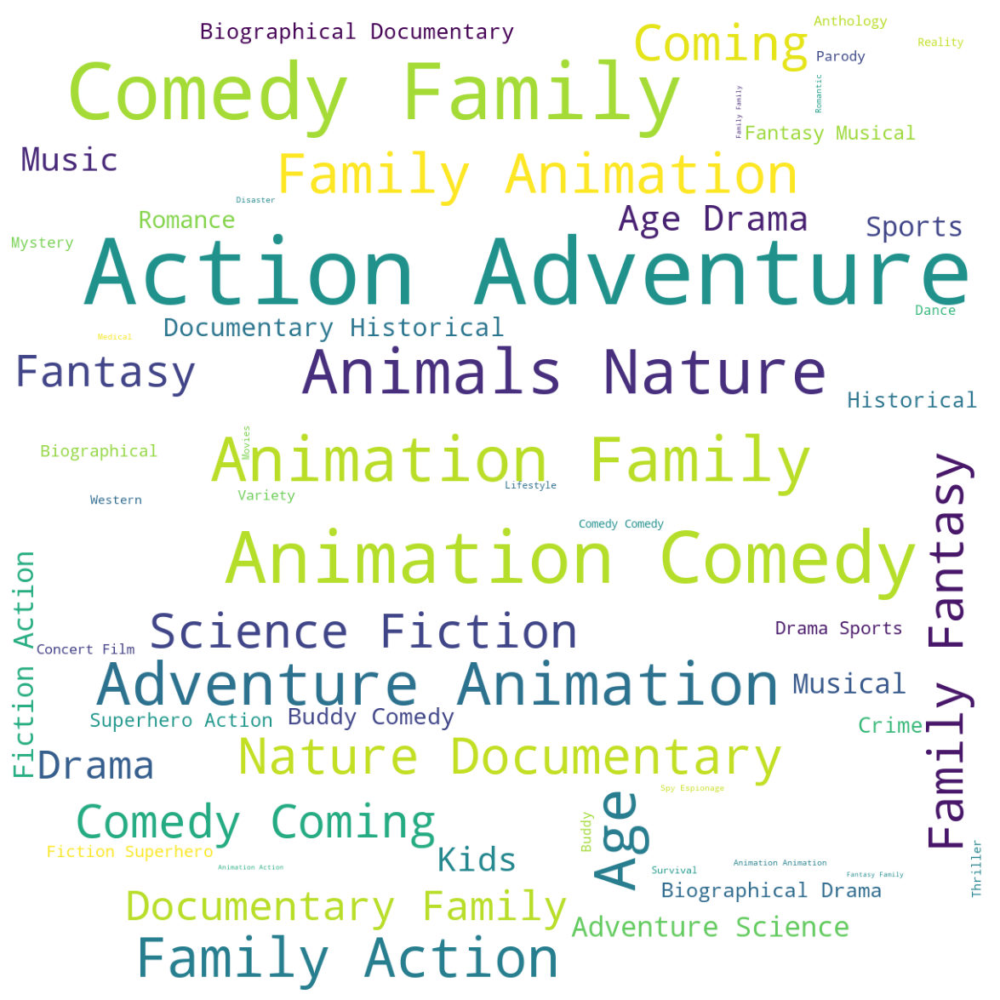

In [108]:
text = str(list(filme_df['genero'])).replace(',', '').replace('[', '').replace("'", '').replace(']', '')

plt.rcParams['figure.figsize'] = (15, 15)
wordcloud = WordCloud(background_color = 'white', width = 1200,  height = 1200, max_words = 121).generate(text)
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [109]:
pip install --upgrade plotly

Note: you may need to restart the kernel to use updated packages.


In [110]:
import plotly.io as pio
pio.renderers.default = 'notebook' 

In [112]:
filme_df['genero_principal'] = filme_df['genero'].apply(lambda genres: genres[0])

In [113]:
genero_ano_df = filme_df[(filme_df['genero_principal'].isin(filme_top_generos)) & (filme_df['ano_adicionado'] >= 2017)].groupby(['genero_principal', 'ano_adicionado']).agg({'title': 'count'})
genero_ano_df = genero_ano_df.reset_index()
genero_ano_df.columns = ['genero_principal', 'ano_adicionado', 'quantidade']

fig = px.sunburst(genero_ano_df, path=['ano_adicionado', 'genero_principal'], values='quantidade')
fig.show()